# Ch7 Application Practice - Crawling "Food, Clothing, Shelter, Transportation, and Entertainment"

In [11]:
pip install selenium

Note: you may need to restart the kernel to use updated packages.


In [12]:
pip install beautifulsoup4

Note: you may need to restart the kernel to use updated packages.


## 7-1 Crawling single web page's single data

* Ex, In MSN weather's web, we can query Taipei's current temperature

https://www.msn.com/zh-tw/weather/forecast/in-台北,台灣   # book is outdated

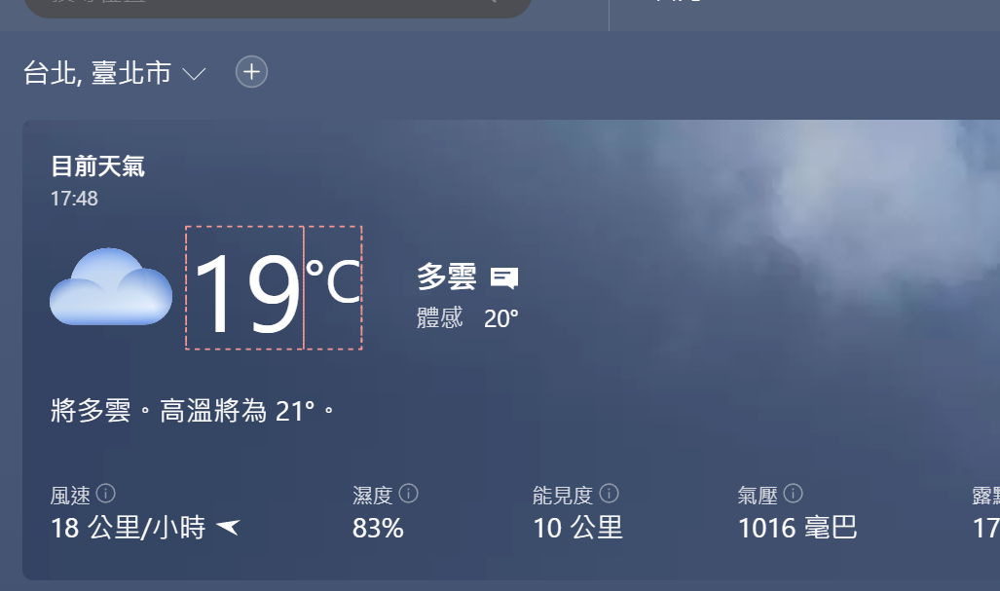

### Analyze HTML web data
* Because close JS. won;'t affect target data, can use chrome devtool to find target data

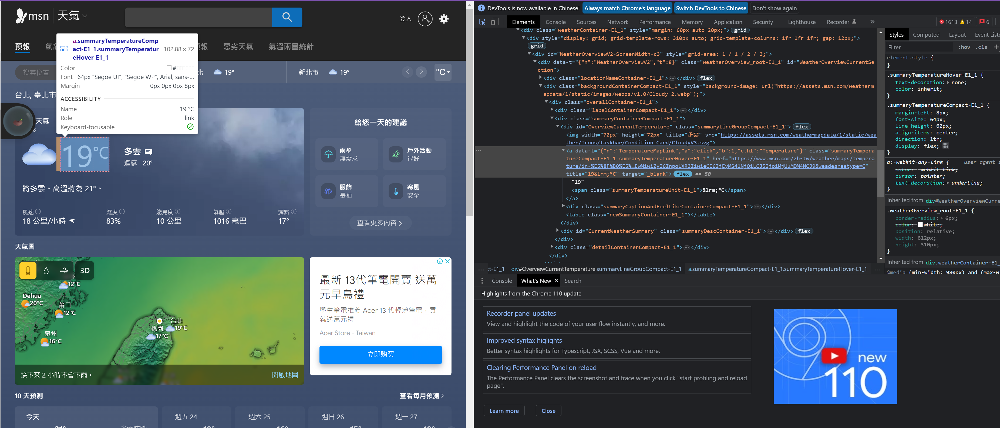

* Can see the class is : summaryTemperatureCompact-E1_1 summaryTemperatureHover-E1_1

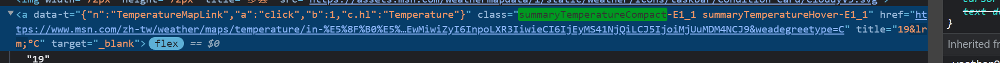

### Crawling taipei current temperature

In [6]:
import requests
from bs4 import BeautifulSoup

url = "https://www.msn.com/zh-tw/weather/forecast/in-台北,台灣"
response = requests.get(url)
soup = BeautifulSoup(response.text, "lxml")
a = soup.find('a', class_="summaryTemperatureCompact-E1_1 summaryTemperatureHover-E1_1")
print(a.text)



18‎°C


### 7-1-2 Crawling 中央氣象局 today temperature range

https://www.cwb.gov.tw/V8/C/W/County/County.html?CID=65

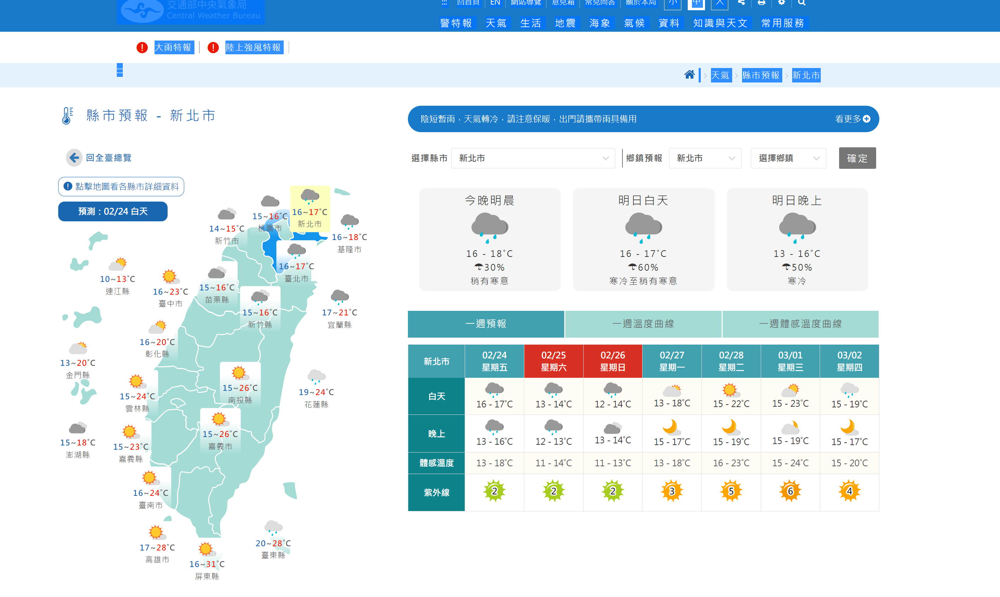

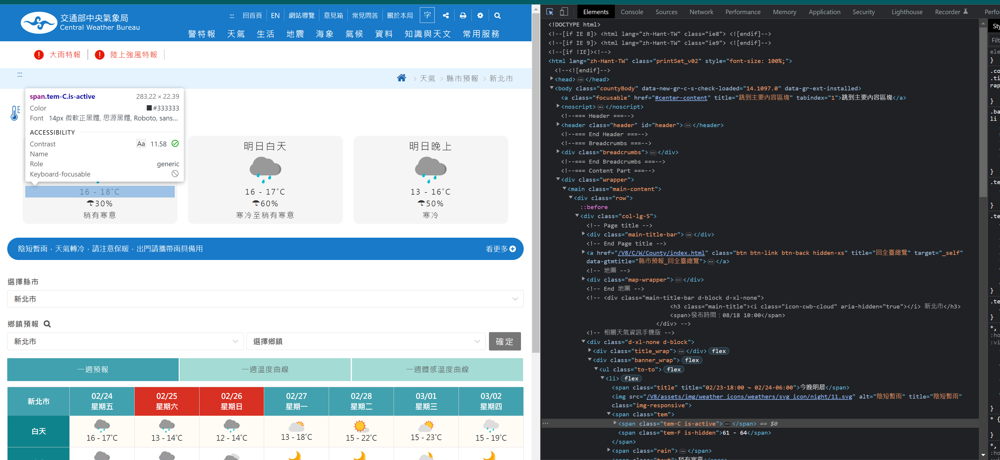

In [2]:
# from above, can see it's span tag
# <span class="tem-C is-active">16 - 18</span>

* right click > copy selector:
** body > div.wrapper > main > div > div:nth-child(1) > div.d-xl-none.d-block > div.banner_wrap > ul > li:nth-child(1) > span.tem > span.tem-C.is-active

* You can test by console:

document.querySelector("span.tem-C.is-active")
* Then we can know it's enough

#### Scrawing the temperature range

* Since the value affected by the JS: (quick javascript switcher)

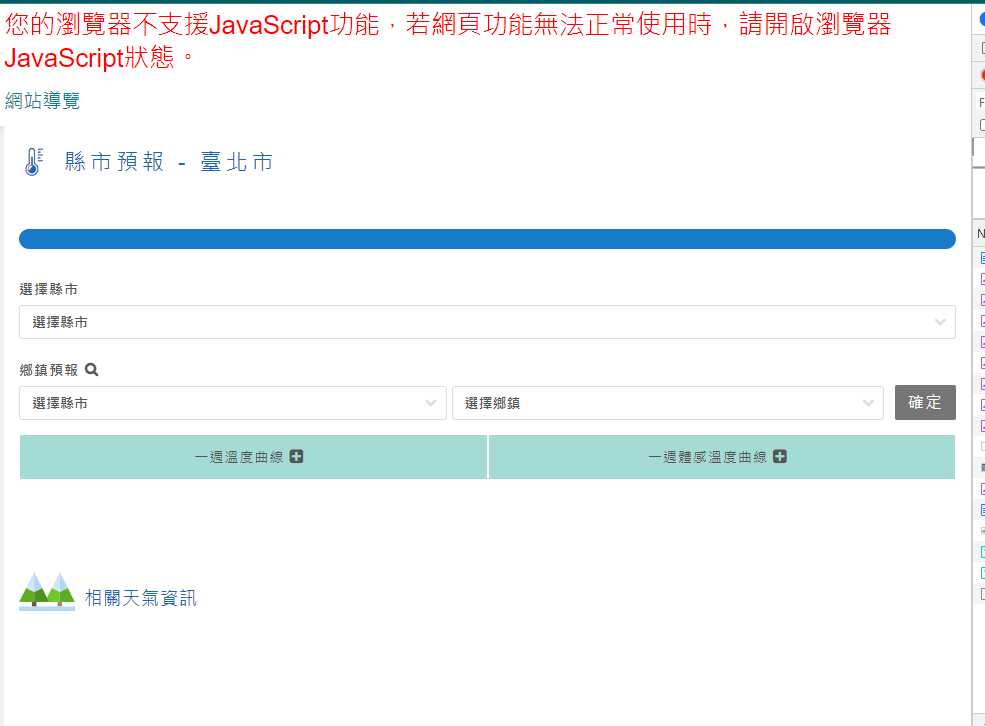

* So we can use python selenium to send the http request 

In [19]:
from selenium import webdriver
from bs4 import BeautifulSoup
from selenium.webdriver.chrome.service import Service

url = "https://www.cwb.gov.tw/V8/C/W/County/County.html?CID=65"
# Remember to update the chromeDriver to match the ver. :https://sites.google.com/chromium.org/driver/

driver = webdriver.Chrome(service=service)   
driver.implicitly_wait(10)
driver.get(url)
soup = BeautifulSoup(driver.page_source, "lxml")
span = soup.select_one("span.tem-C.is-active")
print(span.text)
driver.quit()


16~18


# 7-2 Fetch single web page's single record

Ex, Yahoo Movie:

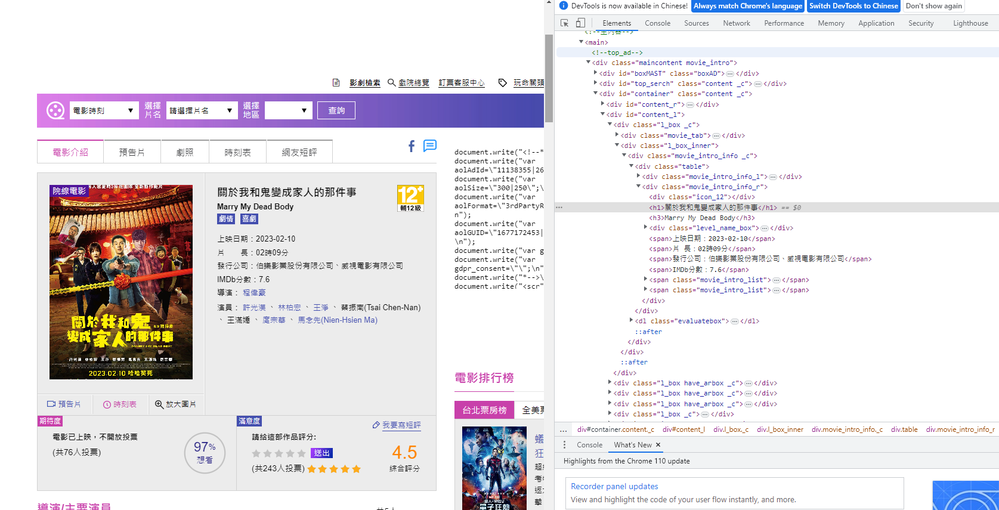

* Analyze HTML:
* Close JS. doesn't affect the target data, can use chrome dev tool 

In [23]:
import requests
from bs4 import BeautifulSoup

# url = "https://movies.yahoo.com.tw/movieinfo_main/復仇者聯盟-終局之戰-avengers-endgame-9728"
url = "https://movies.yahoo.com.tw/movieinfo_main/關於我和鬼變成家人的那件事-marry-my-dead-body-14301"
response = requests.get(url)
soup = BeautifulSoup(response.text, "lxml")
div_p = soup.find('div', class_="table")
img = div_p.find("div", class_="movie_intro_info_l").find("img")
print("劇照:", img.get("src"))
div_info = div_p.find("div", class_="movie_intro_info_r")
title_cht = div_info.find("h1")
print("中文片名:", title_cht.text)
title_en = div_info.find("h3")
print("英文片名:", title_en.text)
date = div_info.find("span")
print(date.text)
length = date.find_next()
print(length.text)
company = length.find_next()
print(company.text)

劇照: https://movies.yahoo.com.tw/i/o/production/movies/January2023/68OHgsKumNGGBoFm2fUX-1080x1565.jpg
中文片名: 關於我和鬼變成家人的那件事
英文片名: Marry My Dead Body
上映日期：2023-02-10
片　　長：02時09分
發行公司：伯樂影業股份有限公司、威視電影有限公司
